# Region parcellation from spatial connectivity 

In [1]:
import h5py
import numpy as np
import matplotlib.pyplot as plt
import os
import sys
from scipy.io import loadmat

## Load data

In [2]:
# W_fn = os.path.join(os.getenv('HOME'),'work/allen/data/connectivities/allvis_sdk_free_noshell/W_ipsi_all_1.0000e+05.h5')

W_fn = os.path.join(os.getenv('HOME'),'work/allen/data/connectivities/extra_vis_friday_harbor/W_ipsi_1e6.h5')
mat_file = os.path.join(os.getenv('HOME'),'work/allen/data/connectivities/extra_vis_friday_harbor/extra_vis_friday_harbor.mat')

f = h5py.File(W_fn,'r')
W = np.array(f.get('dataset'))
locals().update(loadmat(mat_file))

In [3]:
whos

Variable                          Type          Data/Info
---------------------------------------------------------
Lx                                csc_matrix      (0, 0)	-5.0\n  (1, 0)	1<...>	1.0\n  (7496, 7496)	-6.0
Ly_contra                         csc_matrix      (0, 0)	-3.0\n  (2, 0)	1<...>	1.0\n  (7526, 7526)	-5.0
Ly_ipsi                           csc_matrix      (0, 0)	-5.0\n  (1, 0)	1<...>	1.0\n  (7496, 7496)	-6.0
Omega                             csc_matrix      (8, 77)	1.0\n  (8, 84)	<...>95)	1.0\n  (24, 7496)	1.0
W                                 ndarray       7497x7497: 56205009 elems, type `float64`, 449640072 bytes (428 Mb)
W_fn                              str           /home/kameron/work/allen/<...>iday_harbor/W_ipsi_1e6.h5
col_label_list_source             ndarray       7497x1: 7497 elems, type `float64`, 59976 bytes
col_label_list_target_contra      ndarray       7527x1: 7527 elems, type `float64`, 60216 bytes
col_label_list_target_ipsi        ndarray       7497x1: 

In [4]:
def draw_region_labels(int_axis=1):
    '''
    Convenience function that draws region labels
    '''
    int_axis=1
    rearrange_2d=lambda(arr): arr
    #rearrange_2d=lambda(arr): np.fliplr(arr)
    #rearrange_2d=lambda(arr): np.swapaxes(arr,0,1)
    # remap labels
    new_labels = col_label_list_source.copy()
    new_label_map = []
    for i,label in enumerate(np.unique(new_labels)):
        new_labels[new_labels == label] = \
          i+1
        new_label_map.append(label)
    label_grid=map_to_regular_grid(new_labels,
                                   voxel_coords_source).squeeze()
    label_grid[label_grid==0]=np.nan
    label_grid_2d=mode(label_grid, axis=int_axis)[0].squeeze()
    label_grid_2d[label_grid_2d==0]=np.nan
    label_unique=np.unique(new_labels)
    label_grid_2d=rearrange_2d(label_grid_2d)
    for i,label in enumerate(np.unique(col_label_list_source)):
        x,y=centroid_of_region_2d(label_grid_2d, i+1)
        # region_name=source_acro[source_ids==label_lookup[newlab]][0][0]
        region_name=source_acro[source_ids==label][0][0]
        # print "%s centroid at (%d, %d)" % (region_name,x,y)
        plt.annotate(region_name, xy=(x-1., y), fontsize=20)

In [5]:
sys.path.append('/home/kameron/work/allen/src/allen-voxel-network')
print sys.path

['', '/home/kameron/.local/lib/python2.7/site-packages/scikits.talkbox-0.2.5-py2.7-linux-x86_64.egg', '/home/kameron/.local/lib/python2.7/site-packages/PyNN-0.7.5-py2.7.egg', '/home/kameron/.local/lib/python2.7/site-packages/brian-1.4.1-py2.7-linux-x86_64.egg', '/home/kameron/local/anaconda/lib/python2.7/site-packages/progressbar-2.3-py2.7.egg', '/home/kameron/local/anaconda/lib/python2.7/site-packages/friday_harbor-0.6-py2.7.egg', '/home/kameron/local/anaconda/lib/python2.7/site-packages/nest-1.3.0-py2.7.egg', '/home/kameron/local/anaconda/lib/python2.7/site-packages/Brian2-2.0b3-py2.7-linux-x86_64.egg', '/home/kameron/local/anaconda/lib/python2.7/site-packages/scikits.bootstrap-0.3.2-py2.7.egg', '/home/kameron/local/anaconda/lib/python2.7/site-packages/pynrrd-0.2.1-py2.7.egg', '/home/kameron/local/anaconda/lib/python27.zip', '/home/kameron/local/anaconda/lib/python2.7', '/home/kameron/local/anaconda/lib/python2.7/plat-linux2', '/home/kameron/local/anaconda/lib/python2.7/lib-tk', '/ho

In [6]:
print os.path.join(os.getenv('HOME'),'/work/allen/src/allen-voxel-network')

/work/allen/src/allen-voxel-network


## Analyze with NMF

In [7]:
from plotting.voxlib import *
from sklearn.decomposition import NMF

In [8]:
n_components=100
nmf_model = NMF(n_components=n_components)
U = nmf_model.fit_transform(W);
V = nmf_model.components_.T;
print U.shape, V.shape

(7497, 100) (7497, 100)


In [9]:
def map_and_integrate(voxel_data, voxel_coords, int_axis=1, fun=np.sum):
    '''
    Puts the data into a regular grid and integrates over int_axis
    '''
    grid_data = map_to_regular_grid(voxel_data.astype(float), voxel_coords).squeeze()
    int_data = fun(grid_data, axis=int_axis)
    return int_data

In [10]:
u_int = map_and_integrate(U.astype(float), voxel_coords_source)
v_int = map_and_integrate(V.astype(float), voxel_coords_source)

/home/kameron/work/allen/src/allen-voxel-network/plotting/voxlib.py:131: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  Y=np.zeros(dims)
/home/kameron/work/allen/src/allen-voxel-network/plotting/voxlib.py:135: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  Y=np.zeros(base_shape)
/home/kameron/work/allen/src/allen-voxel-network/plotting/voxlib.py:138: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  Y[new_index[0],new_index[1],new_index[2]]=value


In [11]:
print u_int.shape

(33, 36, 100)


/home/kameron/local/anaconda/lib/python2.7/site-packages/matplotlib/pyplot.py:516: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


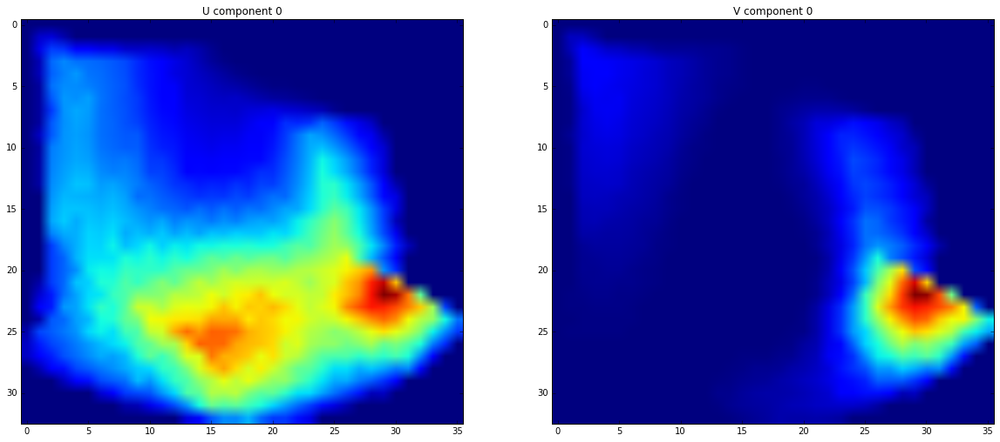

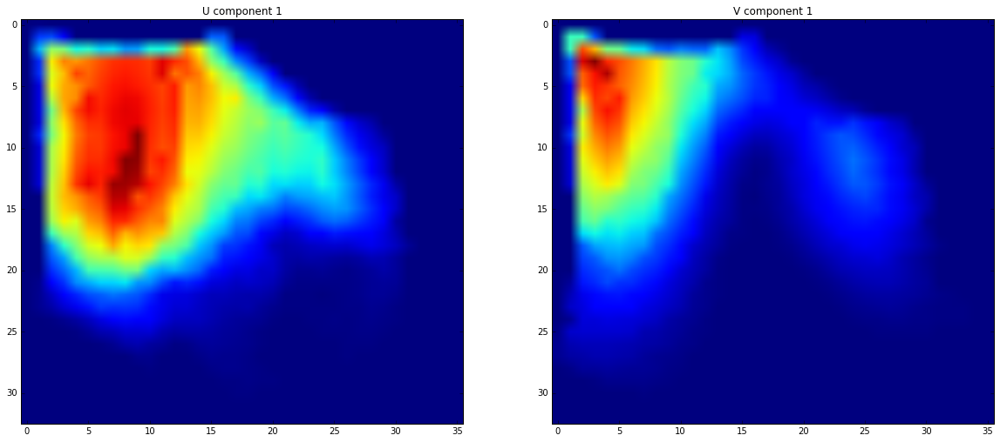

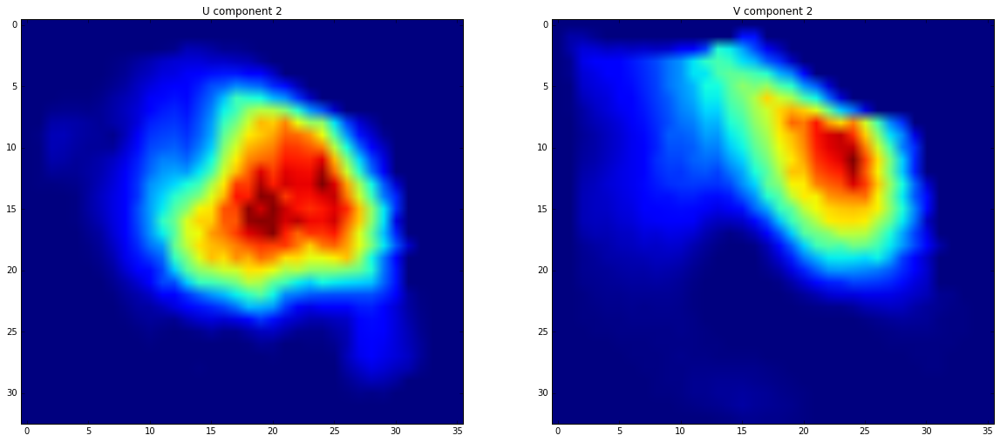

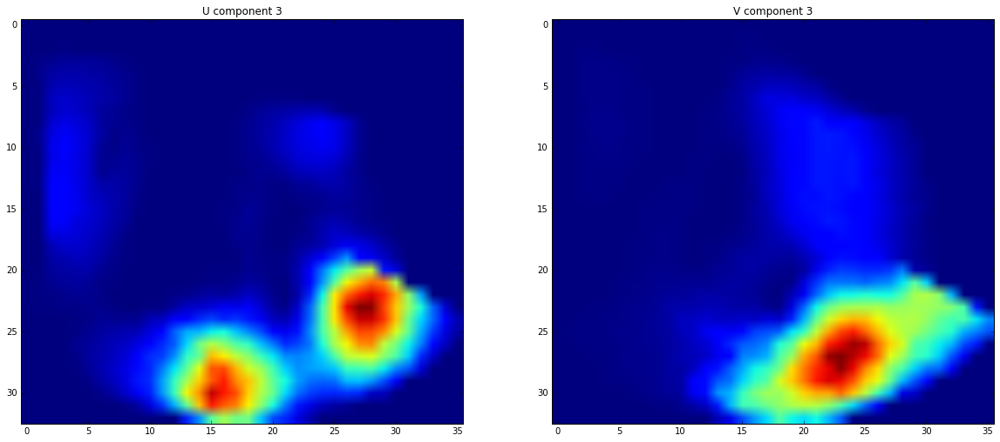

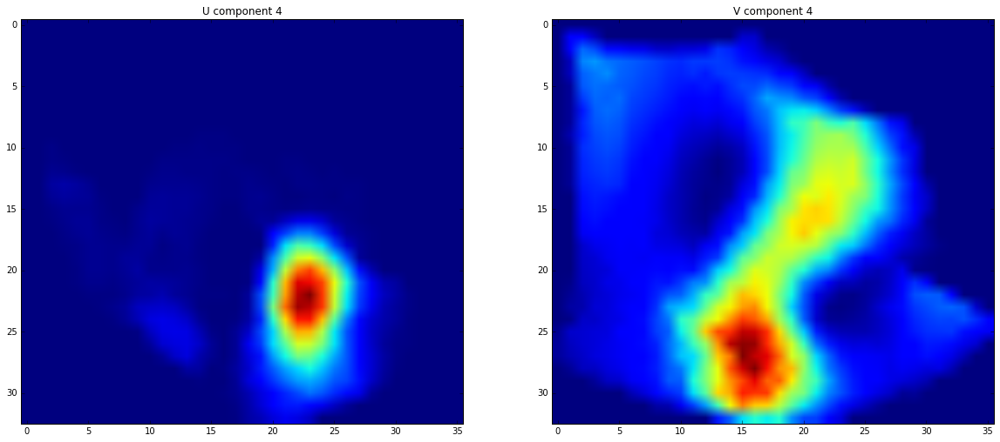

...

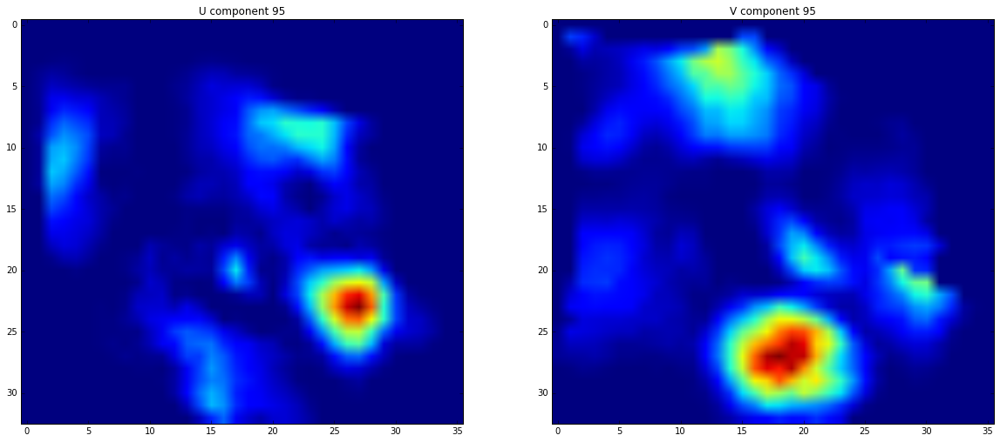

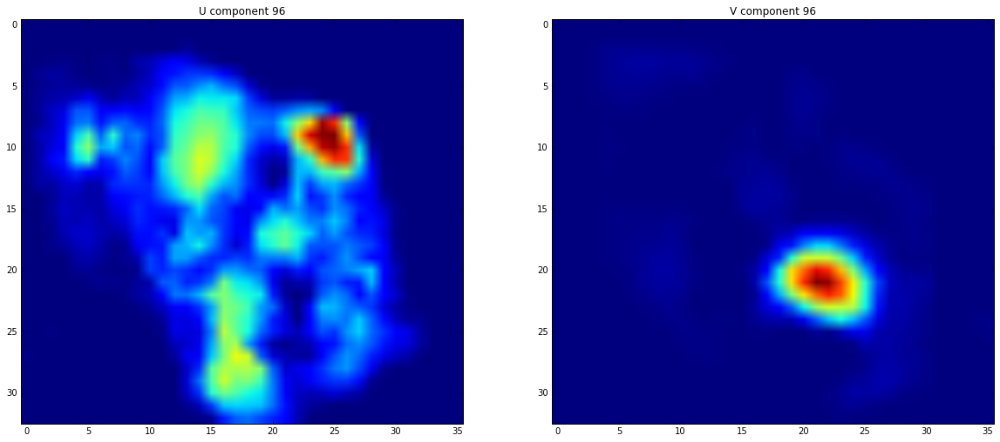

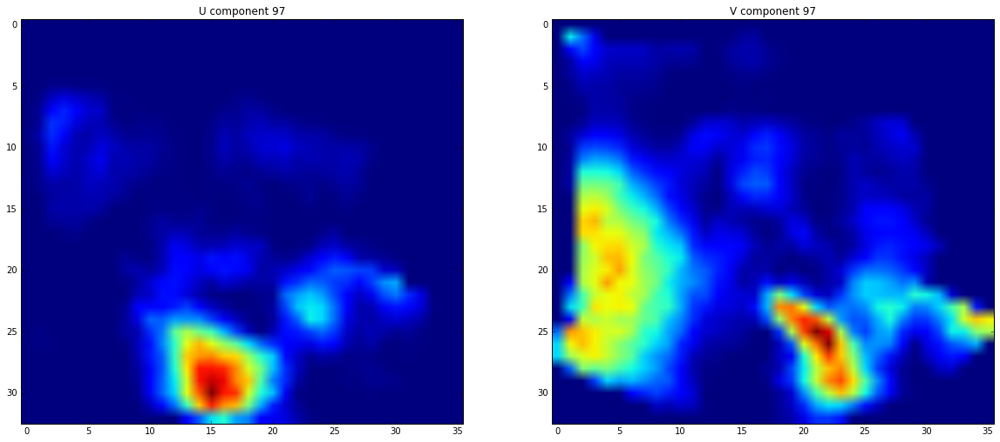

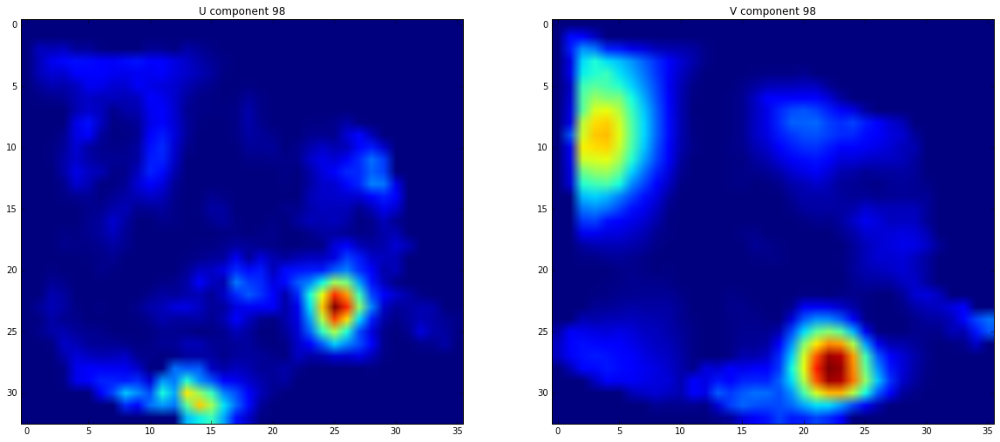

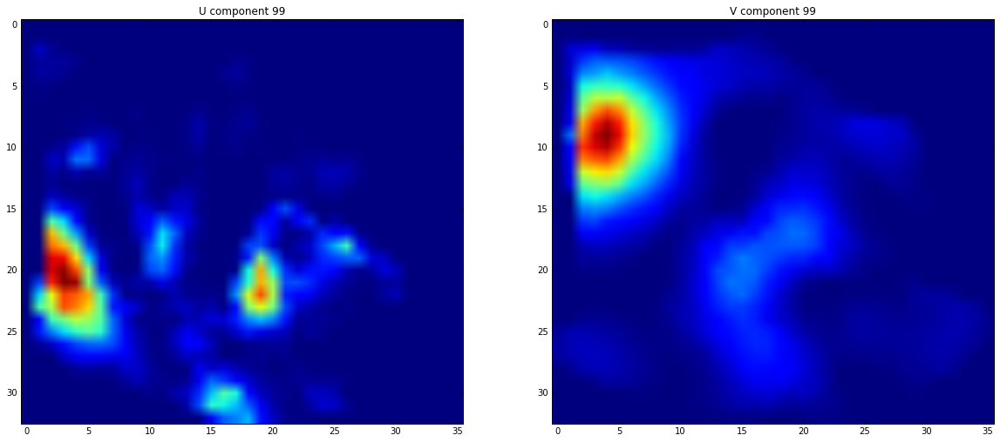

In [12]:
%matplotlib inline
plt.rcParams["figure.figsize"] = [20, 20]
for i in range(n_components):
    fig,(ax1,ax2) = plt.subplots(1,2)
    ax1.imshow(u_int[:,:,i])
    ax1.set_title("U component %d" % i)
    ax2.imshow(v_int[:,:,i])
    ax2.set_title("V component %d" % i)

In [13]:
def normalize_components(U,V):
    assert U.shape[1] == V.shape[1], "U and V have different numbers of columns"
    s = np.zeros(U.shape[1])
    Un = np.zeros(U.shape)
    Vn = np.zeros(V.shape)
    for c in range(U.shape[1]):
        u_norm = np.linalg.norm(U[:,c])
        v_norm = np.linalg.norm(V[:,c])
        s[c] = u_norm * v_norm
        Un[:,c] = U[:,c] / u_norm
        Vn[:,c] = V[:,c] / v_norm
    return (Un,s,Vn)

In [14]:
Un, Sn, Vn = normalize_components(U,V)

In [15]:
component_order = np.flipud(np.argsort(Sn))
Un = Un[:,component_order]
Vn = Vn[:,component_order]
Sn = Sn[component_order]
np.round(Sn*20)

array([ 122.,   80.,   42.,   24.,   22.,   17.,   13.,   10.,    9.,
          9.,    8.,    7.,    6.,    6.,    6.,    5.,    5.,    4.,
          4.,    4.,    4.,    3.,    3.,    3.,    3.,    3.,    3.,
          3.,    3.,    3.,    3.,    2.,    2.,    2.,    2.,    2.,
          2.,    2.,    2.,    2.,    2.,    2.,    2.,    2.,    2.,
          2.,    2.,    2.,    2.,    2.,    2.,    2.,    2.,    2.,
          1.,    1.,    1.,    1.,    1.,    1.,    1.,    1.,    1.,
          1.,    1.,    1.,    1.,    1.,    1.,    1.,    1.,    1.,
          1.,    1.,    1.,    1.,    1.,    1.,    1.,    1.,    1.,
          1.,    1.,    1.,    1.,    1.,    1.,    1.,    1.,    1.,
          1.,    1.,    1.,    1.,    1.,    1.,    1.,    1.,    1.,    0.])

In [16]:
np.linalg.norm(Un[:,0])

1.0000000000000002

In [17]:
def replicate_columns(data, column_counts):
    assert data.ndim == 2, "data should be 2d array"
    assert data.shape[1] == len(column_counts), "each column of data should have a count in column_counts"
    total_col = sum(column_counts)
    column_cumsums = np.cumsum(column_counts)
    data_repl = np.zeros((data.shape[0], total_col))
    for i in range(len(column_counts)):
        if i == 0:
            data_repl[:, 0:column_cumsums[i]] = np.tile(data[:,i],(column_counts[i],1)).T
        else:
            data_repl[:, column_cumsums[i-1]:column_cumsums[i]] = np.tile(data[:,i],(column_counts[i],1)).T
    return data_repl

In [18]:
col_counts = np.round(Sn*20).astype(int)
print col_counts, col_counts.sum()
U_repl = replicate_columns(Un, col_counts)
V_repl = replicate_columns(Vn, col_counts)
U_repl.shape
np.all(U_repl[:,0]==U_repl[:,1])

[122  80  42  24  22  17  13  10   9   9   8   7   6   6   6   5   5   4
   4   4   4   3   3   3   3   3   3   3   3   3   3   2   2   2   2   2
   2   2   2   2   2   2   2   2   2   2   2   2   2   2   2   2   2   2
   1   1   1   1   1   1   1   1   1   1   1   1   1   1   1   1   1   1
   1   1   1   1   1   1   1   1   1   1   1   1   1   1   1   1   1   1
   1   1   1   1   1   1   1   1   1   0] 528


True

In [19]:
U_repl.shape

(7497, 528)

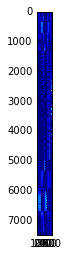

In [20]:
%matplotlib inline
plt.imshow(V_repl)

## Cluster components with K-means (in experiment space)

### (Optionally) Append x-y-z coords

In [ ]:
normalized_coords = voxel_coords_source
#normalized_coords = (normalized_coords - normalized_coords.mean(axis=0)) / normalized_coords.std(axis=0)
for i in range(normalized_coords.shape[1]):
    normalized_coords[:,i] /= np.linalg.norm(normalized_coords[:,i])
normalized_coords

In [ ]:
from sklearn.cluster import KMeans
clust_est = KMeans(n_clusters=10)
#data = np.hstack((U[:,:],V[:,:]))
#data = np.hstack((U_repl, V_repl, normalized_coords))
data = np.hstack((U_repl, V_repl))
#data = Un
clust_est.fit(data)
cluster_labels=np.array(clust_est.labels_, dtype=float) + 1.0

In [28]:
print cluster_labels.shape
print col_label_list_source.shape
#col_label_list_source.squeeze() == 0
#np.unique(cluster_labels)
data.shape

(7497,)
(7497, 1)


(7497, 1054)

/home/kameron/local/anaconda/lib/python2.7/site-packages/IPython/kernel/__main__.py:13: VisibleDeprecationWarning: using a boolean instead of an integer will result in an error in the future


TypeError: Invalid dimensions for image data

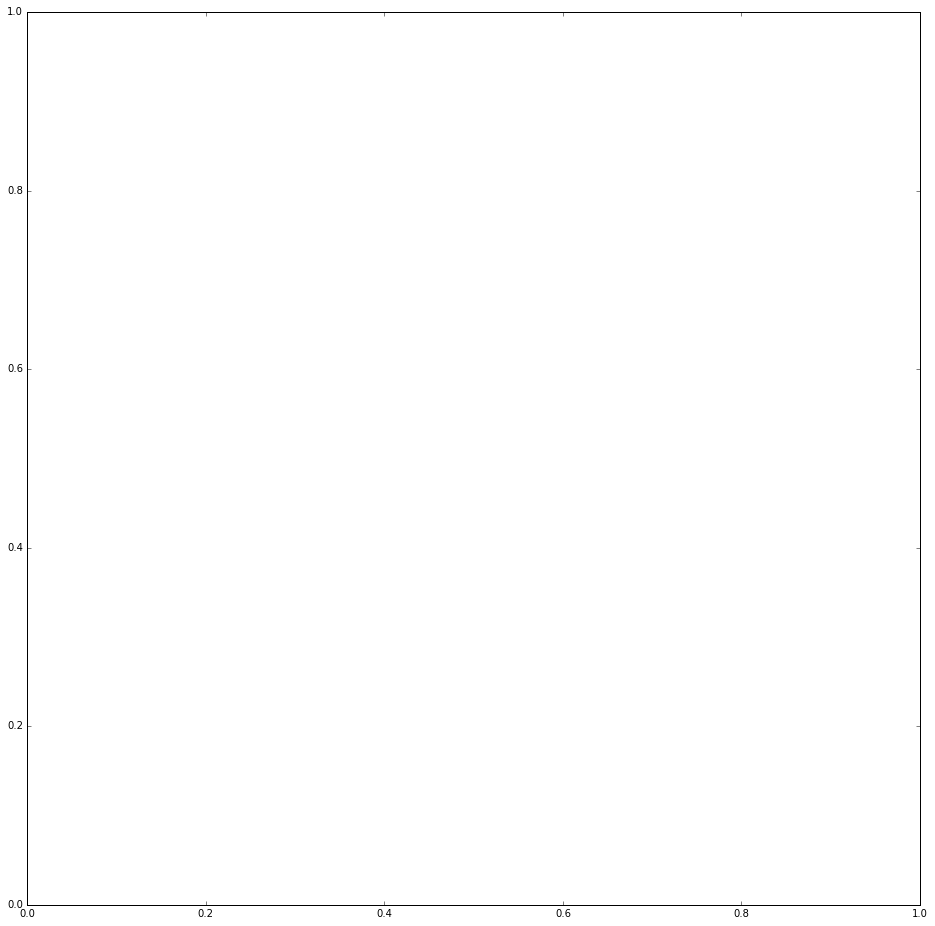

In [29]:
from scipy.stats import mode

def my_mode(data, axis=None):
    return mode(data, axis=axis)[0].squeeze()

# modified_labels = map_to_regular_grid(col_label_list_source, voxel_coords_source)
# modified_labels[modified_labels == 0] = np.nan
# cluster_image = mode(modified_labels, axis=1)[0].squeeze()

modified_labels = map_to_regular_grid(cluster_labels, voxel_coords_source).astype(float)
label_grid = map_to_regular_grid(col_label_list_source,
                                 voxel_coords_source).squeeze()
mask_labels = [ mode(modified_labels[label_grid == 0])[0].squeeze() ]

for l in mask_labels:
    modified_labels[modified_labels == l] = np.nan
cluster_image = mode(modified_labels, axis=1)[0].squeeze()
for l in mask_labels:
    cluster_image[cluster_image == l] = np.nan

plt.rcParams["figure.figsize"] = [16, 16]
fig, ax = plt.subplots(1,1)
ax.imshow(cluster_image, cmap=plt.get_cmap('Accent'), interpolation='none')
draw_region_labels()
plt.savefig("clustering.png")

In [ ]:
cluster_image